# Pairs Trading in Cryptocurrency

## Part 1 Importing data and define functions

In [60]:
import numpy as np
import pandas as pd
from numpy import sign
from numpy import log
from numpy import sqrt
import matplotlib.pyplot as plt
import datetime
import os
import seaborn as sns
sns.set()

import pdb,cx_Oracle,datetime
import sys

import time
import gc
import bottleneck as bn
from datetime import date, timedelta,datetime
import warnings
warnings.filterwarnings("ignore")

from numpy import mat, cov, mean, hstack, multiply,sqrt,diag, \
    squeeze, ones, array, vstack, kron, zeros, eye, savez_compressed
from dateutil.relativedelta import relativedelta
import statsmodels.formula.api as smf
from scipy import stats
from statsmodels.tsa.stattools import coint, adfuller
import itertools
import cufflinks as cf # Imports Cufflinks.
# Imports the offline plotting capabilities of plotly.
import plotly.offline as plyo 
import numpy as np
import plotly.express as px
import plotly.graph_objs as go
import seaborn as sns

In [2]:
import os
os.chdir('D:\Program\AssetPricing\Project')

In [3]:
#找出所有的pairs
def wholepairs(x):
    combos = itertools.combinations(x, 2)
    usable_pairs = []
    for i in combos:
        usable_pairs.append(i)
    return usable_pairs

In [4]:
# 用EG两步法来判断归一后的价格协整
import statsmodels.api as sm
def EG_method(X,Y,show_summary=False):
    
    #step 1
    #estimate long run equilibrium
    model1=sm.OLS(Y,sm.add_constant(X)).fit()
    epsilon=model1.resid
    
    if show_summary:
        print('\nStep 1\n')
        print(model1.summary())
    
    #check p value of augmented dickey fuller test
    #if p value is no larger than 5%, stationary test is passed
    if sm.tsa.stattools.adfuller(epsilon)[1]>0.05:
        return False,model1
    
    #take first order difference of X and Y plus the lagged residual from step 1
    X_dif=sm.add_constant(pd.concat([X.diff(),epsilon.shift(1)],axis=1).dropna())
    Y_dif=Y.diff().dropna()        
    
    #step 2
    #estimate error correction model
    model2=sm.OLS(Y_dif,X_dif).fit()
    
    if show_summary:
        print('\nStep 2\n')
        print(model2.summary())
    
    #adjustment coefficient must be negative
    if list(model2.params)[-1]>0:
        return False,model1
    else:
        return True,model1

In [5]:
#定义一个函数来求出两列数差的std
def ssd(X,Y):
#This function returns the sum of squared differences between two lists, in addition the
#standard deviation of the spread between the two lists are calculated and reported.
    spread = [] #Initialize variables
    std = 0
    mean = 0
    cumdiff = 0
    for i in range(len(X)): #Calculate and store the sum of squares
        cumdiff += (X[i]-Y[i])**2
        spread.append(X[i]-Y[i])
    mean = np.mean(spread) #Calculate the mean
    std = np.std(spread)  #Calculate the standard deviation
    return cumdiff, mean, std

#### - 找出币对的函数

In [6]:
# 定义一个函数来选出最佳pairs 分别有两种方法，第一个是用协整和相关系数，第二个是用最小方差来判断
def bestpairs(rawdata, freqperiod, method):#method输入coint和sum
    begin_date = '2018-3-1'
    end_date = '2019-5-31'
    dates = pd.date_range(begin_date,end_date, freq = freqperiod)
    if method == 'coint':
        bestpairs = pd.DataFrame()
        for m in range(len(dates)-1):
            estimate_data = rawdata[(rawdata['time'] >= dates[m]) & (rawdata['time'] <= dates[m+1])]
            dateperiod = dates[m].date()
            for i in range(len(pairs)):
                
                estimate = estimate_data[[pairs[i][0], pairs[i][1]]]
                # 价格归一化处理
                asset1 = pairs[i][0]
                asset2 = pairs[i][1]
                estimate['asset1NP'] = (estimate[asset1] + 1).cumprod()
                estimate['asset2NP'] = (estimate[asset2] + 1).cumprod()
                
                # 先做协整检验，然后选出通过了协整之后相关系数最高的那一对
                cointresult, cointmodel = EG_method(estimate['asset1NP'], estimate['asset2NP'])
                if cointresult == True:
                    corr = estimate.corr()
                    a = list(estimate['asset1NP'])
                    b = list(estimate['asset2NP'])
                    cumdiff_est, mean_est, std_est = ssd(a, b)
                    out = pd.Series([dateperiod, pairs[i], corr[pairs[i][0]][pairs[i][1]], mean_est, std_est])
                    out = out.T
                    bestpairs = bestpairs.append(out, ignore_index = True)

        bestpairs.columns = ['dateperiod', 'pair', 'corr','mean','std']
        bestpairs = bestpairs.dropna().sort_values(by = ['corr'], ascending = False)
        bestpairs = bestpairs.groupby(['dateperiod']).first().reset_index()
        return dates, bestpairs
    if method == 'sum':
        bestpairs = pd.DataFrame()
        for m in range(len(dates)-1):
            estimate_data = rawdata[(rawdata['time'] >= dates[m]) & (rawdata['time'] <= dates[m+1])]
            dateperiod = dates[m].date()
            for i in range(len(pairs)):
                estimate = estimate_data[[pairs[i][0], pairs[i][1]]]
                # 价格归一化处理
                asset1 = pairs[i][0]
                asset2 = pairs[i][1]
                estimate['asset1NP'] = (estimate[asset1] + 1).cumprod()
                estimate['asset2NP'] = (estimate[asset2] + 1).cumprod()

                a = list(estimate['asset1NP'])
                b = list(estimate['asset2NP'])
                cumdiff_est, mean_est, std_est = ssd(a, b)
                out = pd.Series([dateperiod, pairs[i], cumdiff_est , mean_est, std_est])
                out = out.T
                bestpairs = bestpairs.append(out, ignore_index = True)
        bestpairs.columns = ['dateperiod', 'pair', 'cumdiff','mean','std']
        bestpairs = bestpairs.dropna().sort_values(by = ['cumdiff'], ascending = True)
        bestpairs = bestpairs.groupby(['dateperiod']).first().reset_index()
        return dates, bestpairs     

#### - pairstrading function

In [ ]:
#1
def pairstrading(test, zscore_name, window1, window2, opn, close, stop, price_figure = False, zscore_figure = False, payoff_figure = False): # stop理应是个负数
    openpos = False #一开始没有任何开仓
    # test = test.reset_index()
    test['spread'] = test['asset1NP'] - test['asset2NP']
    test['zscore'] = (test['spread'].rolling(window1).mean() - test['spread'].rolling(window2).mean()) / test['spread'].rolling(window2).std()
    if zscore_name == 'zscorecon':
        test['zscorecon'] = (test['spread'] - meanpair) / stdpair
    test = test.dropna().reset_index()
    test['position'] = np.nan
    test['longasset'] = np.nan
    test['retlong'] = np.nan
    test['retshort'] = np.nan
    test['cost'] = np.nan
    test['retdiff'] = np.nan
    test['retdiff1'] = ''
    test['total_ret'] = np.nan
    retdiff1=[]
    test['drawdown']=''
    test['down']=np.nan
    drawdown=0
    max_drawdown=0
    down=0
    del test['index']
    if price_figure == True:
        fig3, ax = plt.subplots()
        ax.plot(test['time'], test['asset1NP'], label= asset1)
        ax.plot(test['time'], test['asset2NP'], label= asset2)
        ax.legend(loc='upper left')
        plt.suptitle('Price')
        plt.show()

    if zscore_figure == True: #画出开仓关仓的线
        fig3, ax = plt.subplots()
        ax.plot(test['time'], test[zscore_name], label='zscore')
        ax.axhline((-1 * opn), color='green', label = 'open')
        ax.axhline((-1 * close), color='red', linestyle='--', label = 'close')
        ax.axhline((opn), color='green',label = 'open')
        ax.axhline((close), color='red', linestyle='--', label = 'close')
        ax.legend(loc='upper left')
        plt.suptitle('Rolling Spread Z-Score')
        plt.show()

    for i in range(len(test)-2):
        i = i+1
        if openpos == False:
            if (abs(test[zscore_name][i-1]) <= opn)  & (abs(test[zscore_name][i]) >= opn): #在zscore大于opn的时候开仓
                test['position'][i+1] = 'open_begin'

                if test['spread'][i] >= 0:
                    test['longasset'][i+1] = asset2
                    test['retlong'][i+1] = test[asset2][i+1]
                    test['retshort'][i+1] = test[asset1][i+1]
                    test['cost'][i+1] = 0.0006 #单边万三作为手续费
                    test['retdiff'][i+1] = test['retlong'][i+1] - test['retshort'][i+1] - test['cost'][i + 1]
                    #test['retdiff1'][i+1] = 1*(1+test['retdiff'][i+1])
                    test['retdiff1'][i+1] = test['retdiff'][i+1]
                    retdiff1.append(test['retdiff1'][i+1])
                    openpos = True
                if test['spread'][i] < 0:
                    test['longasset'][i+1] = asset1
                    test['retlong'][i+1] = test[asset1][i+1]
                    test['retshort'][i+1] = test[asset2][i+1]
                    test['cost'][i+1] = 0.0006 #单边万三作为手续费
                    test['retdiff'][i+1] = test['retlong'][i+1] - test['retshort'][i+1] - test['cost'][i + 1]
                    #test['retdiff1'][i+1] = 1*(1+test['retdiff'][i+1])
                    test['retdiff1'][i+1] = test['retdiff'][i+1]
                    retdiff1.append(test['retdiff1'][i+1])
                    openpos = True
            else:
                test['retlong'][i+1] = 0
                test['retshort'][i+1] = 0
                test['cost'][i+1] = 0
                test['retdiff'][i+1] = test['retlong'][i+1] - test['retshort'][i+1] - test['cost'][i + 1]
                test['retdiff1'][i+1] = 0
                openpos = False

        if openpos == True:
            if (test['down'][i] != np.nan) & (test['down'][i] > stop):#止损
                test.loc[i+1, 'position'] = 'close_stop'
                test['retlong'][i+1] = 0
                test['retshort'][i+1] = 0
                test['cost'][i+1] = 0.0006 #单边万三作为手续费
                test['retdiff'][i+1] = test['retlong'][i+1] - test['retshort'][i+1] - test['cost'][i + 1]
                #test['retdiff1'][i+1] = test['retdiff1'][i]*(1+test['retdiff'][i+1])
                test['retdiff1'][i+1] = test['retdiff1'][i]+test['retdiff'][i+1]
                test['total_ret'][i+1] = test['retdiff1'][i+1]
                drawdown=np.maximum.accumulate(retdiff1)-retdiff1
                max_drawdown=np.max(drawdown)
                test['drawdown'][i+1]=max_drawdown
                retdiff1=[]
                openpos = False

            else:
                if test['longasset'][i] == asset2:# 即多的是asset2
                    if (abs(test[zscore_name][i]) > close) & (test['spread'][i] >= 0): #持仓
                        test.loc[i+1, 'position'] = 'open'
                        test['longasset'][i+1] = asset2
                        test['retlong'][i+1] = test[asset2][i+1]
                        test['retshort'][i+1] = test[asset1][i+1]
                        test['cost'][i+1] = 0
                        test['retdiff'][i+1] = test['retlong'][i+1] - test['retshort'][i+1] - test['cost'][i+1]
                        #print(test['retdiff1'][i])
                        #test['retdiff1'][i+1] = test['retdiff1'][i]*(1+test['retdiff'][i+1])
                        test['retdiff1'][i+1] = test['retdiff1'][i]+test['retdiff'][i+1]
                        retdiff1.append(test['retdiff1'][i+1])
                        down=np.max(retdiff1)-test['retdiff1'][i+1]
                        test['down'][i+1]=down
                        openpos = True
                    if (abs(test[zscore_name][i]) > close) & (test['spread'][i] < 0): #平仓-avr
                        if abs(test[zscore_name][i]) < opn:
                            test.loc[i+1, 'position'] = 'close-avr'
                            test['retlong'][i+1] = 0
                            test['retshort'][i+1] = 0
                            test['cost'][i+1] = 0.0006 #单边万三作为手续费
                            test['retdiff'][i+1] = test['retlong'][i+1] - test['retshort'][i+1] - test['cost'][i+1]
                            #test['retdiff1'][i+1] = test['retdiff1'][i]*(1+test['retdiff'][i+1])
                            test['retdiff1'][i+1] = test['retdiff1'][i]+test['retdiff'][i+1]
                            test['total_ret'][i+1] = test['retdiff1'][i+1]
                            drawdown=np.maximum.accumulate(retdiff1)-retdiff1
                            max_drawdown=np.max(drawdown)
                            test['drawdown'][i+1]=max_drawdown
                            retdiff1=[]
                            openpos = False
                        else:
                            test.loc[i+1, 'position'] = 'close-open'#平仓-opn
                            test['longasset'][i+1] = asset1
                            test['retlong'][i+1] = test[asset1][i+1]
                            test['retshort'][i+1] = test[asset2][i+1]
                            test['cost'][i+1] = 0.0006 #单边万三作为手续费
                            test['total_ret'][i+1] = test['retdiff1'][i]-0.0006
                            drawdown=np.maximum.accumulate(retdiff1)-retdiff1
                            max_drawdown=np.max(drawdown)
                            test['drawdown'][i+1]=max_drawdown
                            retdiff1=[]
                            test['retdiff'][i+1] = test['retlong'][i+1] - test['retshort'][i+1] - test['cost'][i+1]
                            #test['retdiff1'][i+1] = 1*(1+test['retdiff'][i+1])
                            test['retdiff1'][i+1] = test['retdiff'][i+1]
                            retdiff1.append(test['retdiff1'][i+1])
                            openpos = True

                    if (abs(test[zscore_name][i]) <= close):#平仓
                        test.loc[i+1, 'position'] = 'close'
                        test['retlong'][i+1] = 0
                        test['retshort'][i+1] = 0
                        test['cost'][i+1] = 0.0006 #单边万三作为手续费
                        test['retdiff'][i+1] = test['retlong'][i+1] - test['retshort'][i+1] - test['cost'][i+1]
                        #test['retdiff1'][i+1] = test['retdiff1'][i]*(1+test['retdiff'][i+1])
                        test['retdiff1'][i+1] = test['retdiff1'][i]+test['retdiff'][i+1]
                        test['total_ret'][i+1] = test['retdiff1'][i+1]
                        drawdown=np.maximum.accumulate(retdiff1)-retdiff1
                        max_drawdown=np.max(drawdown)
                        test['drawdown'][i+1]=max_drawdown
                        retdiff1=[]
                        openpos = False

                if test['longasset'][i] == asset1: # 即多的是asset1
                    if (abs(test[zscore_name][i]) > close) & (test['spread'][i] < 0): #持仓
                        test.loc[i+1, 'position'] = 'open'
                        test['longasset'][i+1] = asset1
                        test['retlong'][i+1] = test[asset1][i+1]
                        test['retshort'][i+1] = test[asset2][i+1]
                        test['cost'][i+1] = 0
                        test['retdiff'][i+1] = test['retlong'][i+1] - test['retshort'][i+1] - test['cost'][i+1]
                        #print(test['retdiff1'][i])
                        #test['retdiff1'][i+1] = test['retdiff1'][i]*(1+test['retdiff'][i+1])
                        test['retdiff1'][i+1] = test['retdiff1'][i]+test['retdiff'][i+1]
                        retdiff1.append(test['retdiff1'][i+1])
                        down=np.max(retdiff1)-test['retdiff1'][i+1]
                        test['down'][i+1]=down
                        openpos = True
                    if (abs(test[zscore_name][i]) > close) & (test['spread'][i] >= 0): #平仓-avr
                        if abs(test[zscore_name][i]) < opn:#avr
                            test.loc[i+1, 'position'] = 'close-avr'
                            test['retlong'][i+1] = 0
                            test['retshort'][i+1] = 0
                            test['cost'][i+1] = 0.0006 #单边万三作为手续费
                            test['retdiff'][i+1] = test['retlong'][i+1] - test['retshort'][i+1] - test['cost'][i+1]
                            #test['retdiff1'][i+1] = test['retdiff1'][i]*(1+test['retdiff'][i+1])
                            test['retdiff1'][i+1] = test['retdiff1'][i]+test['retdiff'][i+1]
                            test['total_ret'][i+1] = test['retdiff1'][i+1]
                            drawdown=np.maximum.accumulate(retdiff1)-retdiff1
                            max_drawdown=np.max(drawdown)
                            test['drawdown'][i+1]=max_drawdown
                            retdiff1=[]
                            openpos = False
                        else:
                            test.loc[i+1, 'position'] = 'close-open'#平仓-opn
                            test['longasset'][i+1] = asset2
                            test['retlong'][i+1] = test[asset2][i+1]
                            test['retshort'][i+1] = test[asset1][i+1]
                            test['cost'][i+1] = 0.0006 #单边万三作为手续费
                            test['total_ret'][i+1] = test['retdiff1'][i]-0.0006
                            drawdown=np.maximum.accumulate(retdiff1)-retdiff1
                            max_drawdown=np.max(drawdown)
                            test['drawdown'][i+1]=max_drawdown
                            retdiff1=[]
                            test['retdiff'][i+1] = test['retlong'][i+1] - test['retshort'][i+1] - test['cost'][i+1]
                            #test['retdiff1'][i+1] = 1*(1+test['retdiff'][i+1])
                            test['retdiff1'][i+1] = test['retdiff'][i+1]
                            retdiff1.append(test['retdiff1'][i+1])
                            openpos = True

                    if (abs(test[zscore_name][i]) <= close):#平仓
                        test.loc[i+1, 'position'] = 'close'
                        test['retlong'][i+1] = 0
                        test['retshort'][i+1] = 0
                        test['cost'][i+1] = 0.0006 #单边万三作为手续费
                        test['retdiff'][i+1] = test['retlong'][i+1] - test['retshort'][i+1] - test['cost'][i+1]
                        #test['retdiff1'][i+1] = test['retdiff1'][i]*(1+test['retdiff'][i+1])
                        test['retdiff1'][i+1] = test['retdiff1'][i]+test['retdiff'][i+1]
                        test['total_ret'][i+1] = test['retdiff1'][i+1]
                        drawdown=np.maximum.accumulate(retdiff1)-retdiff1
                        max_drawdown=np.max(drawdown)
                        test['drawdown'][i+1]=max_drawdown
                        retdiff1=[]
                        openpos = False
                    

    test['payoff'] = test['retdiff'].cumsum()

    if payoff_figure == True:
        plt.plot(test['time'], test['payoff'])

    return test

In [106]:
#累加版本
#Bitcon是一个dataframe。列有total_ret是指一次开关仓的收益；cum_ret单利一块钱变成几块钱;retdiff=LONG-SHORT的收益
#调试版-新的最大回撤-成功版本202011261615

def statprod(bitcon,bar,period):#bar是指几分钟线，以分钟为单位;period是指bitcon的时期，以月为单位
    numbers=bitcon.total_ret.count()#total_ret是指一次开关仓的收益
    cum_ret=bitcon.cum_ret.loc[len(bitcon)-1]#计算的是这一个时期的总收益率,单利
    ann_ret=(cum_ret)*(12/period)  #用bitcon收益率计算出的年收益率
    day_ret=bitcon['retdiff']
    cumpnl=bitcon['cum_ret'] 
   # drawdown=np.maximum.accumulate(cumpnl)-cumpnl
   # end=np.argmax(np.maximum.accumulate(cumpnl)-cumpnl)#结束时间【回撤】
   # start=np.argmax(cumpnl[:end]) if cumpnl[:end].shape[0]!=0 else 0#开始时间[回撤]
    max_drawdown=-maxdrawdown(bitcon)
    #calmar=ann_ret/max_drawdown
    calmar=cum_ret/max_drawdown
    day_retfl=day_ret.loc[day_ret!=0]
    ann_std=day_retfl.std()*np.sqrt(365*1440/bar)
    #down_std=(day_ret[day_ret<0]).std()*np.sqrt(252)#div the ret<0 day
    day_retz=day_ret.loc[day_ret<0]
    down_std=day_retz.std()*np.sqrt(365*1440/bar)#div the total day
    sp=ann_ret/ann_std
    sortino=ann_ret/down_std
    win=(bitcon.total_ret>0).sum()/bitcon.total_ret.count()###重新算
    # if the curve is not recorvey at the end day of the test periods, , recover_day==last day
    #recover_day=cumpnl[cumpnl>cumpnl[start]].index[0] if cumpnl[cumpnl>cumpnl[start]].shape[0]>0 else cumpnl.index[-1]
    #end_day=cumpnl.index[end] 
    #rec_days=(recover_day-end_day)/(60/bar)
    average=cum_ret/numbers
    opnr=len(day_retfl)/len(bitcon)
    avel=(len(day_retfl)/numbers)/(60/bar)
    
    statistic_table=pd.DataFrame({'1 Numbers of transactions ':int(numbers),
                                  '2 Cumulative Return':cum_ret,
                                  '3 Annual Return':ann_ret,
                                  '4 Max Drawdown':max_drawdown,
                                  '5 Calmar Ratio':calmar,
                                  '6 Annual volitility':ann_std,
                                  '7 Down side volitility':down_std,
                                  '8 Sharp Ratio':sp,
                                  '9 Sortino Ratio':sortino,
                                  '10 Win Rate':win,
                                  #'11 Max Recovery hours':rec_days,
                                  '11 Average Return per transaction':average,
                                  '12 Open ratio':opnr,
                                  '13 Average  time(hours)':avel},
                            index=[str('Statistic Table')]).T
    return round(statistic_table,4)

def maxdrawdown(bit):#计算最大回撤
    bit['d']=''
    bit['d'] = bit['retdiff'].apply(lambda x: 1 if x>0 else(0 if x==0 else -1 ))
    bit['de']=np.nan
    bit['ded']=np.nan
    

    for i in range(len(bit)):
    
        if i==0:
            if (bit['d'][0] == -1)&(bit['d'][1] != -1):#第一步负，后面非负
                bit['de'][0]=bit['retdiff'][0]
                bit['ded'][0]=bit['de'][0]
            elif (bit['d'][0] == -1)&(bit['d'][1] == -1):#第一步负，后面也都是负
                bit['de'][0]=bit['retdiff'][0]
                
       
        if (i>0)&(i<len(bit)-1):
            if (bit['d'][i-1] != -1) & (bit['d'][i] == -1):#前非后负
                bit['de'][i]=bit['retdiff'][i]
        
            elif (bit['d'][i-1] == -1) & (bit['d'][i] == -1):#前负后负
                bit['de'][i]=bit['de'][i-1]+bit['retdiff'][i]
        
            elif (bit['d'][i-1] == -1) & (bit['d'][i] != -1):#前负后非
                bit['ded'][i-1] = bit['de'][i-1]
                
        elif i==len(bit)-1:
            if bit['d'][i]==-1:
                if bit['d'][i-1]!=-1:
                    bit['de'][i]=bit['retdiff'][i]
                    bit['ded'][i]=bit['de'][i] 
                if bit['d'][i-1]==-1:
                    bit['de'][i]=bit['de'][i-1]+bit['retdiff'][i]
                    bit['ded'][i] = bit['de'][i]
                
    
    
    bit['ded']=bit['ded'].fillna(0)
    m=bit['ded'].min()
    return m

In [113]:
rawdata = pd.read_csv('22_ret5m.csv', index_col='time', parse_dates=True) # 时间是从2018年3月1日到2019年5月31日
rawdata = rawdata.resample(rule = '5min', label='right').last()
currname = rawdata.columns.values #在reset之前就取好
pairs = wholepairs(currname) #所有的pairs
rawdata = rawdata.reset_index()

In [114]:
dates, best_pairs = bestpairs(rawdata, '20D', 'sum')

In [169]:
best_pairs

,dateperiod,pair,cumdiff,mean,std
0,2018-03-01,"(ETHUSD, QSHUSD)",2.496607,0.008969,0.018788
1,2018-03-21,"(ETHUSD, LTCUSD)",1.982035,-0.004948,0.017876
2,2018-04-10,"(ETHUSD, ZECUSD)",8.378420,0.004227,0.037901
3,2018-04-30,"(BTGUSD, QTMUSD)",3.625058,0.001817,0.025019
4,2018-05-20,"(ETHUSD, BTGUSD)",1.724433,0.001305,0.017252
5,2018-06-09,"(LTCUSD, XLMUSD)",1.214852,0.003159,0.014174
6,2018-06-29,"(ETHUSD, LTCUSD)",3.253774,-0.001456,0.023721
7,2018-07-19,"(ETHUSD, LTCUSD)",1.162471,-0.008163,0.011626
8,2018-08-08,"(ETHUSD, ZECUSD)",5.351416,-0.019115,0.023738
9,2018-08-28,"(QTMUSD, TRXUSD)",3.601242,-0.001419,0.024962


## Part3 参数调整

### - 1. 调整bar和period
- 注意要说这里要画两个热力图

In [73]:
statresult = pd.DataFrame()
x1 = ['5min', '10min', '15min', '20min', '25min', '30min', '35min', '40min', '45min', '50min', '55min', '60min']
x2 = ['10D','15D','20D','25D','30D']
for k in x1:
    if 'time' in rawdata.columns:
        rawdata = rawdata.set_index('time')
    rawdata1 = rawdata.resample(rule = k, label='right').last()
    currname = rawdata1.columns.values #在reset之前就取好
    pairs = wholepairs(currname) #所有的pairs
    rawdata1 = rawdata1.reset_index()
    #选择pairs所用的期间段
    for j in x2:
        dates,best_pairs = bestpairs(rawdata1, j,'sum')
        print(k,j)
        wholeret = pd.DataFrame()
        for i in range(len(best_pairs)-1):
        # for i in range(len(best_pairs)-1):
            bestpair = best_pairs['pair'][i]
            meanpair = best_pairs['mean'][i]
            stdpair = best_pairs['std'][i]
            test_data = rawdata1[(rawdata1['time'] >= dates[i+1]) & (rawdata1['time'] <= dates[i+2])] 

            asset1 = bestpair[0]
            asset2 = bestpair[1]
            test = test_data[[asset1, asset2,'time']].dropna()
            test['asset1NP'] = (test[asset1] + 1).cumprod()
            test['asset2NP'] = (test[asset2] + 1).cumprod()
            result = pairstrading(test,'zscore',1, 60, 0.25, 0, 100, price_figure = False, zscore_figure=False, payoff_figure=False)

            result1 = result.copy()#然后把result给合并在一起2，停止
            result11 = result1[['time','retdiff','total_ret']].copy()
            resultall = pd.concat([resultall,result11],ignore_index = True )

        result2 = resultall.copy()
        result2['retdiff'] = result2['retdiff'].fillna(method='bfill')
        result2['cum_ret'] = result2['retdiff'].cumsum()#计算出来的累乘收益情况，一块钱变成几块钱
        result2.rename(columns={'time':'DATE'},inplace=True)
        
        stat = statprod(result2, int(k[0:2]), 15)
        stat.loc['bar'] = k
        stat.loc['period'] = j
        stat = stat.T
        statresult = statresult.append(stat, ignore_index = True)

10min 10D
10min 15D


### - 2.调整开关仓的条件——open和close

In [161]:
%%time
x1 = [0.1,0.15,0.25,0.5,0.75,1,1.5]
x2 = [0,0.1,0.15,0.25,0.5,0.75,1,1.5]
statresult = pd.DataFrame()
for opn in x1:
    for close in x2:
        if opn > close:
            print(opn,close)
            wholeret = pd.DataFrame()
            resultall=pd.DataFrame()
            # for i in range(5):
            for i in range(len(best_pairs)-1):
                bestpair = best_pairs['pair'][i]
                meanpair = best_pairs['mean'][i]
                stdpair = best_pairs['std'][i]
                test_data = rawdata[(rawdata['time'] >= dates[i+1]) & (rawdata['time'] <= dates[i+2])] 
                
                asset1 = bestpair[0]
                asset2 = bestpair[1]
                test = test_data[[asset1, asset2,'time']].dropna()
                test['asset1NP'] = (test[asset1] + 1).cumprod()
                test['asset2NP'] = (test[asset2] + 1).cumprod()
                result = pairstrading(test,'zscore', 1, 60, opn, close, 10)
                result1 = result.copy()#然后把result给合并在一起2，停止
                result11 = result1[['time','retdiff','total_ret']].copy()
                resultall = pd.concat([resultall,result11],ignore_index = True )

            result2 = resultall.copy()
            result2['retdiff'] = result2['retdiff'].fillna(method='bfill')
            result2['cum_ret'] = result2['retdiff'].cumsum()#计算出来的累乘收益情况，一块钱变成几块钱
            result2.rename(columns={'time':'DATE'},inplace=True)
            stat = statprod(result2, 5, 15)
            stat.loc['open'] = opn
            stat.loc['close'] = close
            stat = stat.T
            statresult = statresult.append(stat, ignore_index = True)

0.1 0
0.15 0
0.15 0.1
0.25 0
0.25 0.1
0.25 0.15
0.5 0
0.5 0.1
0.5 0.15
0.5 0.25
0.75 0
0.75 0.1
0.75 0.15
0.75 0.25
0.75 0.5
1 0
1 0.1
1 0.15
1 0.25
1 0.5
1 0.75
1.5 0
1.5 0.1
1.5 0.15
1.5 0.25
1.5 0.5
1.5 0.75
1.5 1
Wall time: 1h 50min 55s


In [165]:
statresult2 = statresult2.set_index(['open', 'close'])
statresult2.rename(columns={'2 Cumulative Return':'cumret'}, inplace = True)
CumulativeReturn = statresult2.cumret.unstack()


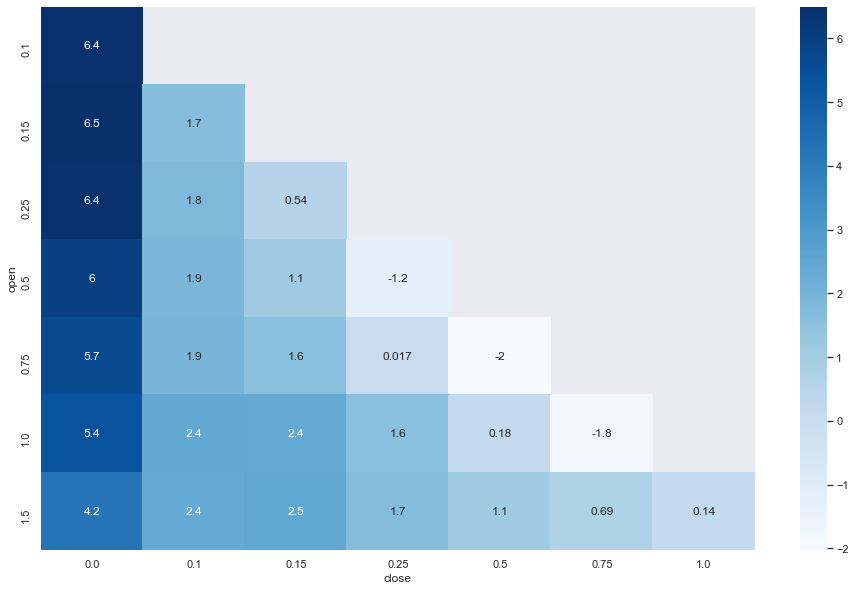

In [166]:
f,ax = plt.subplots(figsize=(16,10)) 
ax = sns.heatmap(CumulativeReturn,annot=True,cmap = 'Blues')
plt.show()

### - 3.调整zscore的window1和window2

In [144]:
%%time
x1 = [1,3,5,10]
x2 = [5,10,20,30,50,60,80]
statresult = pd.DataFrame()
for window1 in x1:
    for window2 in x2:
        if window1 < window2:
            print(window1,window2)
            wholeret = pd.DataFrame()
            resultall=pd.DataFrame()
            # for i in range(5):
            for i in range(len(best_pairs)-1):
                bestpair = best_pairs['pair'][i]
                meanpair = best_pairs['mean'][i]
                stdpair = best_pairs['std'][i]
                test_data = rawdata[(rawdata['time'] >= dates[i+1]) & (rawdata['time'] <= dates[i+2])] 
                
                asset1 = bestpair[0]
                asset2 = bestpair[1]
                test = test_data[[asset1, asset2,'time']].dropna()
                test['asset1NP'] = (test[asset1] + 1).cumprod()
                test['asset2NP'] = (test[asset2] + 1).cumprod()
                result = pairstrading(test,'zscore', window1, window2, 0.25, 0, 10)
                result1 = result.copy()#然后把result给合并在一起2，停止
                result11 = result1[['time','retdiff','total_ret']].copy()
                resultall = pd.concat([resultall,result11],ignore_index = True )

            result2 = resultall.copy()
            result2['retdiff'] = result2['retdiff'].fillna(method='bfill')
            result2['cum_ret'] = result2['retdiff'].cumsum()#计算出来的累乘收益情况，一块钱变成几块钱
            result2.rename(columns={'time':'DATE'},inplace=True)
            stat = statprod(result2, 5, 15)
            stat.loc['window1'] = window1
            stat.loc['window2'] = window2
            stat = stat.T
            statresult = statresult.append(stat, ignore_index = True)

1 5
1 10
1 20
1 30
1 50
1 60
1 80
3 5
3 10
3 20
3 30
3 50
3 60
3 80
5 10
5 20
5 30
5 50
5 60
5 80
10 20
10 30
10 50
10 60
10 80
Wall time: 1h 10min


In [146]:
statresult1 = statresult1.set_index(['window1', 'window2'])
statresult1.rename(columns={'2 Cumulative Return':'cumret'}, inplace = True)
CumulativeReturn = statresult1.cumret.unstack()
statresult1

1 Numbers of transactions   cumret  3 Annual Return  \
window1 window2                                                        
1.0     5.0                          2324.0  6.9579           5.5663   
        10.0                         2121.0  7.1061           5.6849   
        20.0                         2032.0  6.7319           5.3855   
        30.0                         2034.0  6.6955           5.3564   
        50.0                         2012.0  6.4703           5.1762   
        60.0                         1991.0  6.4059           5.1247   
        80.0                         1939.0  6.1099           4.8879   
3.0     5.0                          2169.0  6.1552           4.9242   
        10.0                         2034.0  6.5276           5.2221   
        20.0                         2050.0  6.7198           5.3758   
        30.0                         2037.0  6.5226           5.2181   
        50.0                         2003.0  6.5016           5.2013   
        60.0                         1977.0  6.3525           5.0820   
        80.0                         1942.0  6.1068           4.8854   
5.0     10.0                         2001.0  6.4512           5.1609   
        20.0                         2061.0  6.7311           5.3849   
        30.0                         2013.0  6.4328           5.1462   
        50.0                         1984.0  6.4537           5.1630   
        60.0                         1982.0  6.3994           5.1195   
        80.0                         1932.0  6.0758           4.8606   
10.0    20.0                         1899.0  6.0713           4.8571   
        30.0                         1929.0  6.1289           4.9031   
        50.0                         1914.0  6.1241           4.8992   
        60.0                         1927.0  6.2683           5.0147   
        80.0                         1883.0  6.0029           4.8023   

                 4 Max Drawdown  5 Calmar Ratio  6 Annual volitility  \
window1 window2                                                        
1.0     5.0              0.1124         61.8942               1.4056   
        10.0             0.1124         63.2128               1.4062   
        20.0             0.1124         59.8841               1.4064   
        30.0             0.1124         59.5601               1.4057   
        50.0             0.1124         57.5565               1.4061   
        60.0             0.1124         56.9836               1.4068   
        80.0             0.1124         54.3504               1.4068   
3.0     5.0              0.1124         54.7541               1.4014   
        10.0             0.1124         58.0661               1.4046   
        20.0             0.1124         59.7761               1.4065   
        30.0             0.1124         58.0223               1.4052   
        50.0             0.1124         57.8354               1.4064   
        60.0             0.1124         56.5092               1.4068   
        80.0             0.1124         54.3232               1.4064   
5.0     10.0             0.1124         57.3866               1.4041   
        20.0             0.1124         59.8767               1.4062   
        30.0             0.1124         57.2231               1.4068   
        50.0             0.1124         57.4093               1.4062   
        60.0             0.1124         56.9257               1.4063   
        80.0             0.1124         54.0474               1.4073   
10.0    20.0             0.1124         54.0076               1.4043   
        30.0             0.1124         54.5196               1.4051   
        50.0             0.1124         54.4766               1.4065   
        60.0             0.1124         55.7600               1.4072   
        80.0             0.1124         53.3988               1.4091   

                 7 Down side volitility  8 Sharp Ratio  9 Sortino Ratio  \
window1 window2                                     

In [168]:
statresult1.to_csv('windowadj.csv')

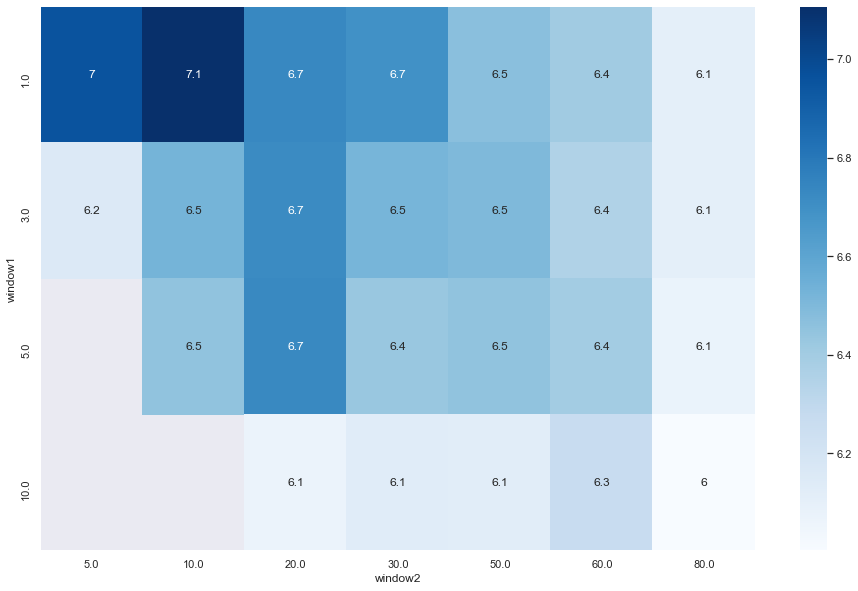

In [147]:
f,ax = plt.subplots(figsize=(16,10)) 
ax = sns.heatmap(CumulativeReturn,annot=True,cmap = 'Blues')
plt.show()

#### 用三对最优参数来进行策略
- 和未进行参数调节的结果进行对比

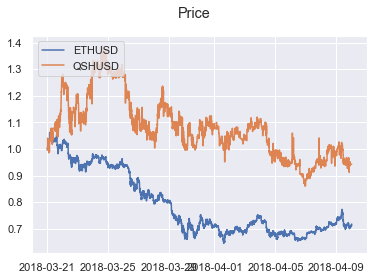

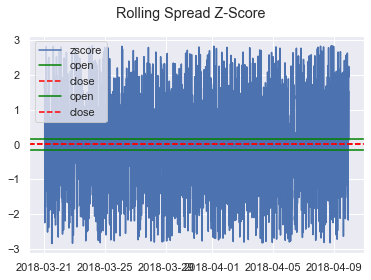

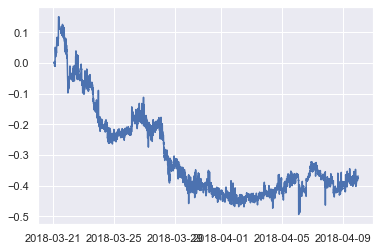

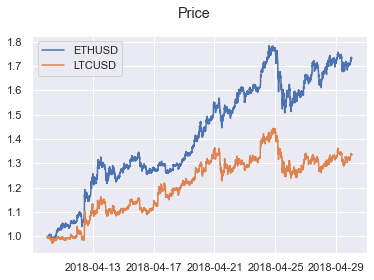

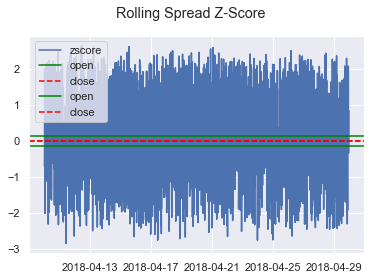

...

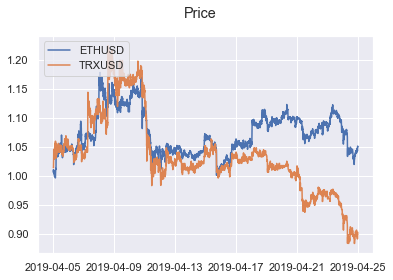

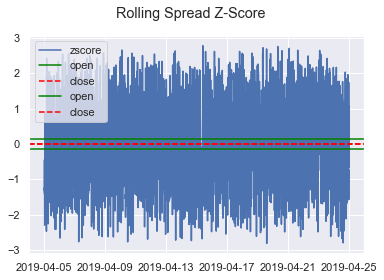

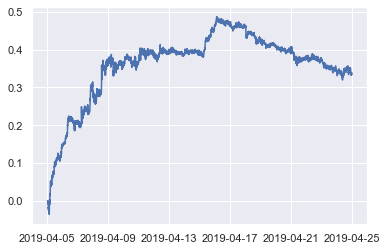

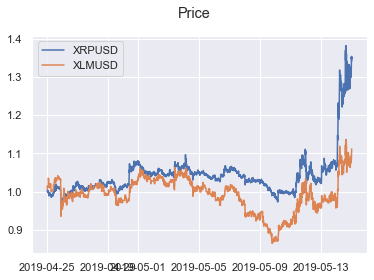

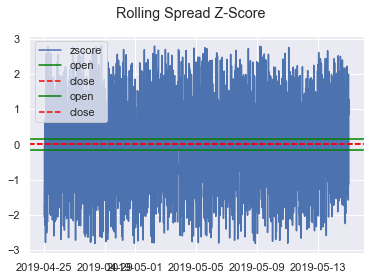

Wall time: 4min 1s


,Statistic Table
1 Numbers of transactions,2150.0000
2 Cumulative Return,7.0952
3 Annual Return,5.6761
4 Max Drawdown,0.1124
5 Calmar Ratio,63.1151
6 Annual volitility,0.6289
7 Down side volitility,0.5129
8 Sharp Ratio,9.0260
9 Sortino Ratio,11.0666
10 Win Rate,0.9028


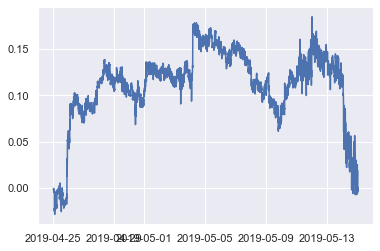

In [170]:
%%time
statresult = pd.DataFrame()
wholeret = pd.DataFrame()

# for i in range(2):
for i in range(len(best_pairs)-1):
    bestpair = best_pairs['pair'][i]
    meanpair = best_pairs['mean'][i]
    stdpair = best_pairs['std'][i]
    test_data = rawdata[(rawdata['time'] >= dates[i+1]) & (rawdata['time'] <= dates[i+2])] 
    
    asset1 = bestpair[0]
    asset2 = bestpair[1]
    test = test_data[[asset1, asset2,'time']].dropna()
    test['asset1NP'] = (test[asset1] + 1).cumprod()
    test['asset2NP'] = (test[asset2] + 1).cumprod()

    result = pairstrading(test,'zscore',1, 10, 0.15, 0, 100, price_figure = True, zscore_figure=True, payoff_figure=True)
    
    ret = result[['time','total_ret', 'retdiff']]
    wholeret = wholeret.append(ret, ignore_index=True)

wholeret['retdiff'] = wholeret['retdiff'].fillna(method='bfill')
wholeret['cum_ret'] = wholeret['retdiff'].cumsum()
wholeret1 = wholeret.copy()
wholeret1.rename(columns={'time':'DATE'}, inplace=True)
stat = statprod(wholeret1,25,15)
stat

In [172]:
stat.to_excel('afteradj.xlsx')

In [171]:
cumret = wholeret[['time', 'cum_ret']].set_index('time')
plyo.init_notebook_mode(connected = True)
layout = {
    'title': 'After Parameter Adjustment',
    'xaxis': {'title': {'text': 'time'},'zeroline': False}, 
    'yaxis': {'title': {'text': 'cumulative return'}, 'zeroline': False}
    }
plyo.iplot(cumret.iplot(asFigure = True, layout = layout))